In [253]:
import pandas as pd
import datetime
import streamlit as st
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from PIL import Image, ImageColor
import numpy as np
import os
import geopandas
import matplotlib.colors as colors
from collections import Counter

# Wordcloud

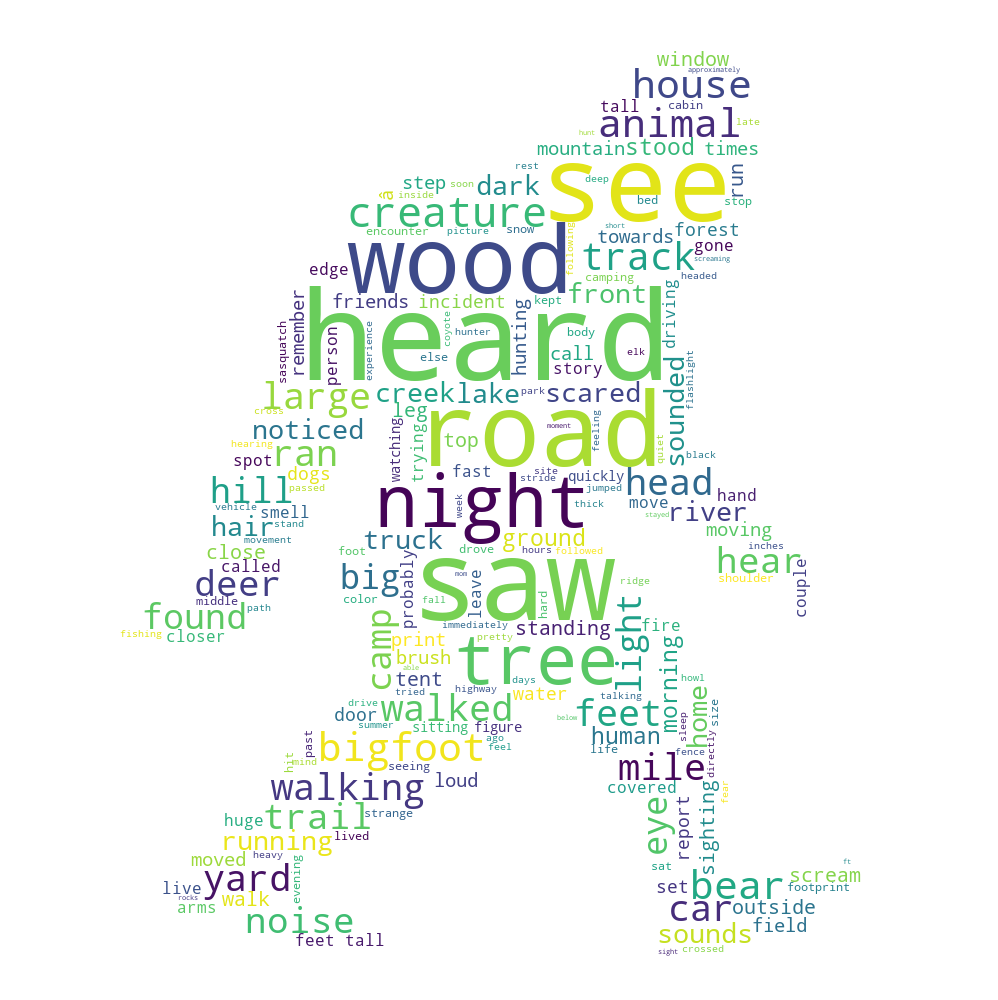

In [254]:
with open('stopwords.txt', 'r') as file:
    words = file.read()
stopwordList = words.split()

text = open('obs.txt', 'r', encoding='utf-8', errors='ignore').read()
mask_fname = np.array(Image.open('new.png'))



wc = WordCloud(stopwords = stopwordList,
    background_color= 'white',
         mask = mask_fname,
         contour_width = 0,
         contour_color = 'black').generate(text)

image = wc.to_image()
image

In [255]:
counties = geopandas.read_file('cb_2018_us_county_5m.shp')

bigfoot = pd.read_csv('bigfoot.csv')
bf = bigfoot.dropna(subset = ['latitude','longitude'])
bigfoot_g = geopandas.GeoDataFrame(bigfoot, geometry=geopandas.points_from_xy(bigfoot.longitude, bigfoot.latitude))

In [256]:
bf2 = bf[bf['latitude'] < 55]
print(len(bf), len(bf2))

3797 3786


# Locations of Bigfoot Sightings 

In [261]:
import plotly.graph_objects as go
bf2.observed = bf2.observed.astype(str).str.wrap(30)
bf2.observed = bf2.observed.apply(lambda x: x.replace('\n', '<br>'))
fig = go.Figure(data=go.Scattergeo(
        lon = bf2.loc[:,'longitude'],
        lat = bf2.loc[:,'latitude'],
        text = bf2.loc[:,'observed'],
        mode = 'markers',
        marker=dict(
            color='Yellow',
            size=5,
            line=dict(
                color='MediumPurple',
                width=1))
        ))

fig.update_layout(
        title = 'Locations of Bigfoot Sightings <br>(Hover for markers)',
        geo_scope='usa',
    )

# Chloropleth

In [55]:
not_needed = '02 15 78 72 60 66 69'

for i in not_needed.split():
    counties = counties[counties.STATEFP != i]

In [56]:
from shapely.ops import cascaded_union
usa = geopandas.GeoSeries(cascaded_union(counties.geometry))

In [57]:
in_usa = [sighting.within(usa.geometry[0]) for sighting in bigfoot_g.geometry]
bigfoot = bigfoot[in_usa]

In [58]:
counties['FIPS'] = counties['STATEFP'].astype(str) + counties['COUNTYFP'].astype(str)

In [59]:
for sighting in bigfoot.index:
  in_county = [bigfoot.geometry[sighting].within(poly) for poly in counties.geometry]
  county = str(counties[in_county].FIPS.values)
  bigfoot.loc[sighting, 'county'] = counties[in_county].FIPS.values

Text(1.0, 1.0, 'Bigfoot Sightings in each United States County')

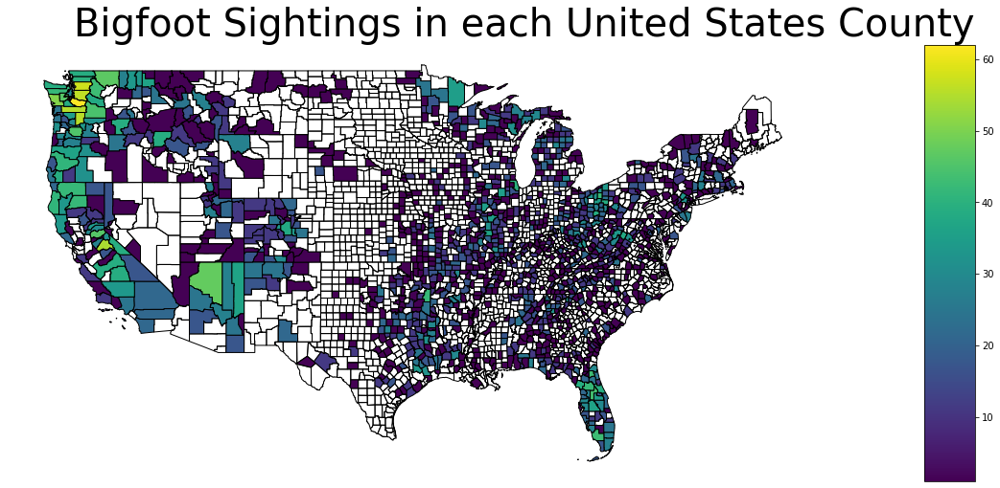

In [118]:
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable
bigfoot = geopandas.GeoDataFrame(bigfoot, crs = "EPSG:4326",
                                 geometry = geopandas.points_from_xy(bigfoot.longitude, bigfoot.latitude))

sighting_by_county = Counter(bigfoot.county)

counties['county_sightings'] = [sighting_by_county[county] for county in counties.FIPS]

fig, ax = plt.subplots(figsize=(20,20))
plot = counties.plot(ax=ax, column = 'county_sightings', cmap='viridis', edgecolor = 'black', norm=colors.LogNorm())

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(plt.cm.ScalarMappable(norm=plt.Normalize(vmin=1, vmax=62), cmap="viridis"), cax=cax)

# fig.colorbar(plt.cm.ScalarMappable(norm=plt.Normalize(vmin=1, vmax=62), cmap="viridis"), ax=ax)

ax.axis("off")
plt.title("Bigfoot Sightings in each United States County", fontsize=40, loc = 'right')


# Education Vs number of sightings

In [65]:
df2 = pd.read_csv('Educationn.csv')

In [73]:
df2['FIPS Code']=df2['FIPS Code'].astype(str)

In [190]:
df3 = counties.merge(df2, how= 'inner', left_on = 'FIPS', right_on = 'FIPS Code')
df3= df3.drop(columns =['STATEFP','LSAD', 'ALAND', 'AWATER', 'COUNTYFP', 'COUNTYNS', 'AFFGEOID', 'GEOID','Percent of adults completing four years of college or higher, 1970',
       'Percent of adults completing four years of college or higher, 1980',
       "Percent of adults with a bachelor's degree or higher, 1990",
       "Percent of adults with a bachelor's degree or higher, 2000",
       "Percent of adults with a bachelor's degree or higher, 2015-19"])

Text(0.5, 1.0, "% Bachelor's Degree attainment vs Bigfoot Sightings \n (United States County-level)")

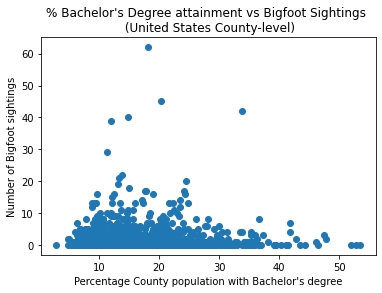

In [233]:
plt.scatter(df3['Average_bachelors_education'], df3["county_sightings"])
plt.xlabel("Percentage County population with Bachelor's degree")
plt.ylabel('Number of Bigfoot sightings')
plt.title("% Bachelor's Degree attainment vs Bigfoot Sightings \n (United States County-level)")

In [227]:
df5 = pd.read_csv('population.csv')
# df5 = df5['STCOU'].dropna()
# df5['STCOU']=df5['STCOU'].astype(int)

df5['FIPS']=df5['FIPS'].astype(str)
df5['FIPS'] = df5['FIPS'].str.zfill(5)
df6 = counties.merge(df5, how= 'left', on= 'FIPS')
df6= df6.drop(columns =[' 2010 POPULATION ','STATE FIPS', 'COUNTY FIPS','STATE/TERRITORY NAME'])
# df6 =df6[df6['FIPS'] == '6037']
# df6
df6 = df6.fillna('0')
df6[' 2015 POPULATION ']=df6[' 2015 POPULATION '].str.replace(',','').astype(int)

Text(0.5, 1.0, 'Population vs Bigfoot Sightings \n (United States County-level)')

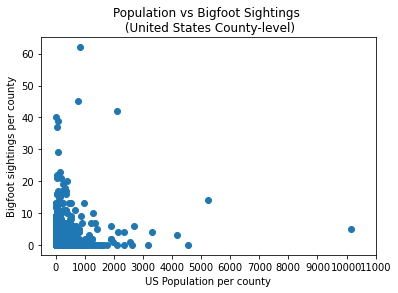

In [232]:
plt.scatter(df6[' 2015 POPULATION ']/1000, df6["county_sightings"])
plt.xticks(np.arange(0,12000, 1000))
plt.xlabel('US Population per county')
plt.ylabel('Bigfoot sightings per county')
plt.title('Population vs Bigfoot Sightings \n (United States County-level)')

In [160]:
bigfoot = pd.read_csv('bigfoot.csv')
columns = 'latitude,longitude,date,classification'.split(',')
data = bigfoot[columns]
data = data.dropna(subset=['latitude', 'longitude'])
data['date'] = data['date'].str.replace('/','-')
data['date'] = pd.to_datetime(data['date'], infer_datetime_format=True)
data = data.set_index(data['date'])
data = data[data.date.dt.year != 1869]
for i in data['date']:
    if i.year> 2018:
        data.loc[i,'date'] = datetime.datetime(i.year-100, i.month, i.day)
data = data.set_index(data['date'])

Text(0.5, 0, 'Year')

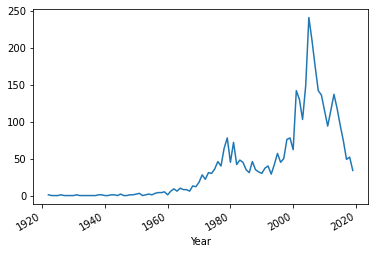

In [234]:
newdf = data['classification'].resample('Y').count().sort_values()
newdf.plot()
plt.xlabel('Year')
plt.ylabel('Number of Bigfoot sightings')
plt.title('')